<h1> Analisa Perjalanan Driver Uber di United States

Data perjalanan uber di Unites States dengan total data 14 jt baris dimana mengandung semua data perjalanan dari Base yang dilewati dan juga data geografis penjemputan driver

<h1>Import Libraries

In [1]:
import pandas as pd
import numpy as np
from google.colab import drive
import os
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Load Data Uber

In [2]:
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Melihat file apa saja yang terdapat dalam path tersebut
files=os.listdir(r'drive/MyDrive/Datasets/uber')
files

['uber-raw-data-aug14.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
path=r'drive/MyDrive/Datasets/uber'

final=pd.DataFrame()

# Membaca File Sekaligus dengan format yang sama (jumlah kolom sama)

for file in files:
  df=pd.read_csv(path+'/'+file,encoding='utf-8')
  final=pd.concat([df,final])

# Examining Data

sebelum masuk ke proses analisa , kita harus memeriksa data sebelum dilakukan proses analisa lebih dalam. Data yang di gunakan terlebih dahulu melalui proses pemeriksaan dengan tujuan data yang di olah sudah sesuai dan tepat. Dalam proses ini kita juga dapat melihat secara umum isi data dan struktur data tersebut. 

In [5]:
final.sample(10)

,Date/Time,Lat,Lon,Base
62120,8/4/2014 23:32:00,40.7417,-73.9764,B02598
174646,9/18/2014 5:30:00,40.8688,-73.9219,B02598
288360,7/2/2014 7:21:00,40.7898,-73.9802,B02617
544826,7/28/2014 10:53:00,40.7646,-73.9720,B02617
315213,9/4/2014 16:24:00,40.7535,-73.9725,B02617
157120,6/15/2014 15:56:00,40.7375,-74.0071,B02598
154168,5/15/2014 6:22:00,40.6710,-73.9263,B02598
721439,7/22/2014 9:30:00,40.7657,-73.9805,B02682
614080,7/5/2014 2:09:00,40.7710,-73.9251,B02682
433039,9/12/2014 23:55:00,40.8482,-73.9394,B02617


In [6]:
final.shape

(4534327, 4)

In [7]:
final.describe()

,Lat,Lon
count,4.534327e+06,4.534327e+06
mean,4.073926e+01,-7.397302e+01
std,3.994991e-02,5.726670e-02
min,3.965690e+01,-7.492900e+01
25%,4.072110e+01,-7.399650e+01
50%,4.074220e+01,-7.398340e+01
75%,4.076100e+01,-7.396530e+01
max,4.211660e+01,-7.206660e+01


In [8]:
final.describe(include='object')

,Date/Time,Base
count,4534327,4534327
unique,260093,5
top,4/7/2014 20:21:00,B02617
freq,97,1458853


In [9]:
final.isnull().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [10]:
## Duplicated 
df[df.duplicated(keep=False)]

## File duplicat ini tidak bisa dihapus karena kemungkinan terdapat titik lat dan lot serta Base id yang sama karena data yang ada tidak lengkap

,Date/Time,Lat,Lon,Base
75,9/1/2014 8:59:00,40.6950,-74.1780,B02512
76,9/1/2014 8:59:00,40.6950,-74.1780,B02512
152,9/1/2014 11:24:00,40.7249,-74.0354,B02512
153,9/1/2014 11:24:00,40.7249,-74.0354,B02512
204,9/1/2014 12:30:00,40.7214,-74.0409,B02512
...,...,...,...,...
1028065,9/30/2014 22:39:00,40.7714,-73.9502,B02764
1028094,9/30/2014 22:46:00,40.7277,-73.9893,B02764
1028095,9/30/2014 22:46:00,40.7277,-73.9893,B02764
1028099,9/30/2014 22:47:00,40.7212,-74.0048,B02764


In [11]:
df.columns

Index(['Date/Time', 'Lat', 'Lon', 'Base'], dtype='object')

# Data Preparation

Pada Tahap ini kita sudah mulai mempersiapkan data sesuai kebutuhan dengan melakukan penambahan data, perubahan data dan menyesuaikan dengan struktur data yang tepat untuk mendukung proses analisa nanti

In [12]:
df=final.copy()

In [13]:
df['Date/Time']=pd.to_datetime(df['Date/Time'],format='%m/%d/%Y %H:%M:%S')

In [14]:
# Menambah Kolom Baru

df['weekday']=df['Date/Time'].dt.day_name()
df['day']=df['Date/Time'].dt.day
df['minute']=df['Date/Time'].dt.minute
df['month']=df['Date/Time'].dt.month
df['hour']=df['Date/Time'].dt.hour
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


# Data Manipulation

In [15]:
df.Base.unique()

array(['B02512', 'B02598', 'B02617', 'B02682', 'B02764'], dtype=object)

In [16]:
df.day.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31])

In [17]:
df.weekday.unique()

array(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday',
       'Sunday'], dtype=object)

# Exploratory Data Analysis (EDA)

Pada Tahap ini kita akan mulai analisa data secara umum, dengan bantuan diagram chart sebagai visualisasi guna mempermudah penyampaian informasi yang terkandung di dalamnya


## Analysis 1 

> Pada Hari apa traffic uber paling banyak dan sedikit di tahun 2014





In [18]:
import plotly.express as px

In [19]:
px.bar(x=df['weekday'].value_counts().index,
       y=df['weekday'].value_counts().values)


In [20]:
df['weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: weekday, dtype: int64

## Analysis 2
> Pada jam berapa traffic uber tertinggi dan terendah

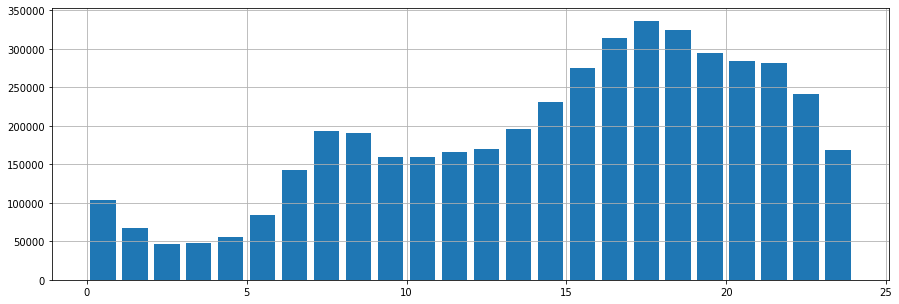

In [21]:
plt.figure(figsize=(15,5))
df['hour'].hist(bins=24,rwidth=.8,range=(0,24))
plt.show()

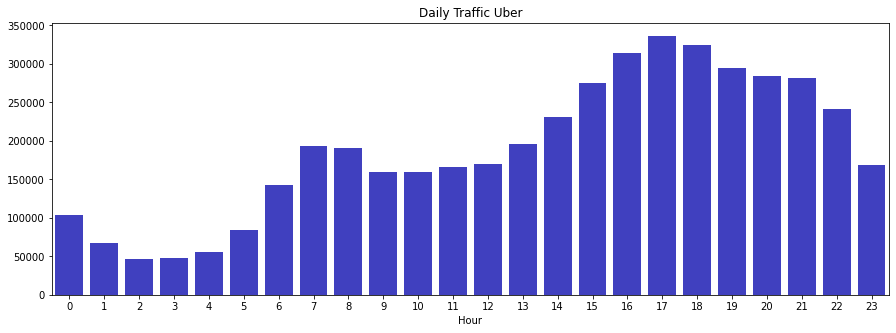

In [22]:
plt.figure(figsize=(15,5))
ax=sns.countplot(data=df, x='hour',color='blue',saturation=0.5,dodge=True)
plt.xlabel('Hour')
plt.ylabel('');
plt.title('Daily Traffic Uber');

In [23]:
px.histogram(df['hour'])

## Analysis 3
> Pada setiap bulannya , jam berapa traffic uber tertinggi dan terendah

In [24]:
### Kenapa menggunakan for dengan enumerate karena kita akan menggunakan index nya sebagai posisi dalam subplot
for i,month in enumerate(df['month'].unique()):
  print('index',i,'bulan',month)

index 0 bulan 9
index 1 bulan 5
index 2 bulan 6
index 3 bulan 7
index 4 bulan 4
index 5 bulan 8


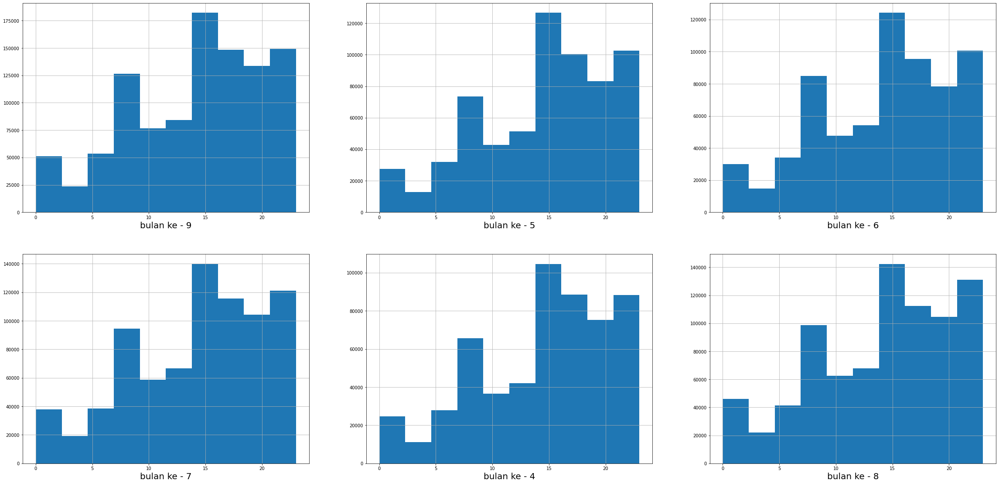

In [25]:
plt.figure(figsize=(40,30))
for i,month in enumerate(df['month'].unique()):
  # index dari enumerate bekerja disini
  plt.subplot(3,3,i+1)
  # untuk month hasil looping bekerja disini
  df[df['month']==month]['hour'].hist()
  # Menampilkan nama bulan yang ke berapa hasil loping
  plt.xlabel('bulan ke - %i'%month,fontsize=20)

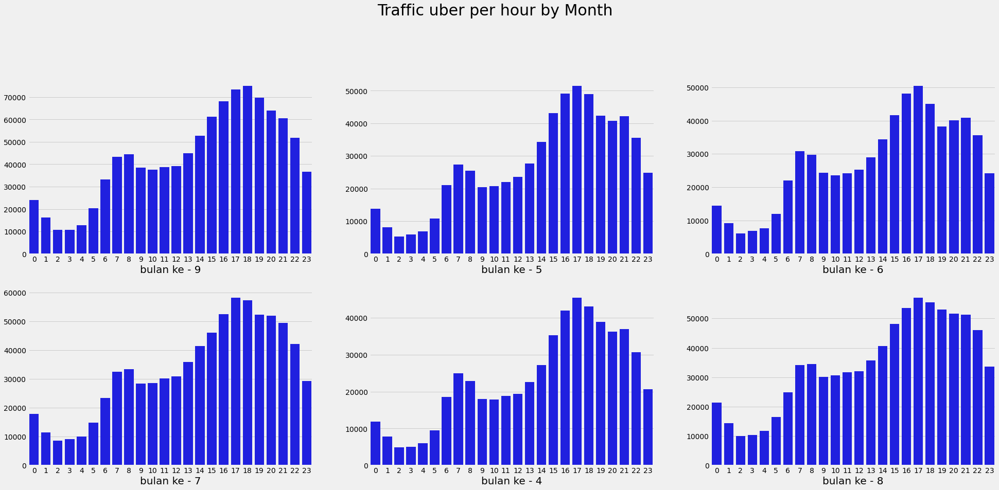

In [32]:
plt.figure(figsize=(30,20))
plt.style.use('fivethirtyeight')
for i , bulan in enumerate(df['month'].unique()):
  plt.subplot(3,3,i+1)
  ax=sns.countplot(data=df[df['month']==bulan], x='hour',color='blue')
  plt.xlabel('bulan ke - %i'%bulan,fontsize=20)
  plt.ylabel('')
  plt.suptitle('Traffic uber per hour by Month',size=30)

## Analysis 4
> Pada jam berapa, setiap bulanya traffic uber teringgi dan terendah

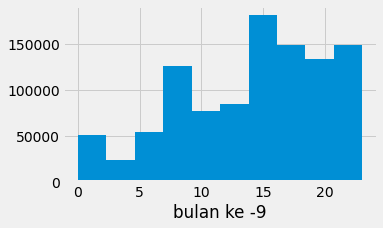

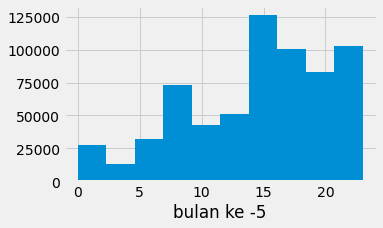

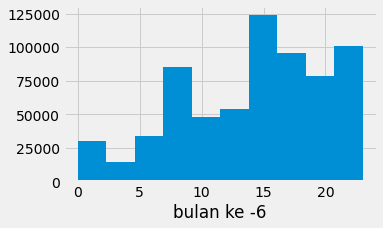

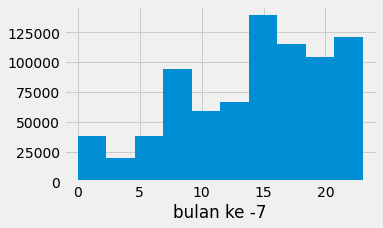

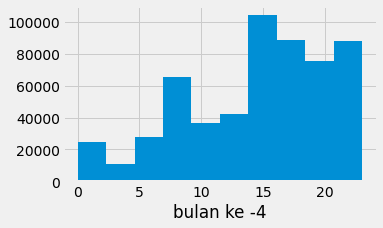

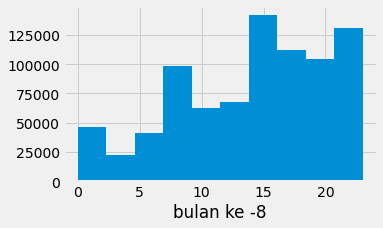

In [33]:
for i in df['month'].unique():
  plt.figure(figsize=(5,3))
  df[df['month']==i]['hour'].hist()
  plt.xlabel ('bulan ke -%i'%i)

## Analysis 5
> Pada bulan apa total traffic uber paling lama

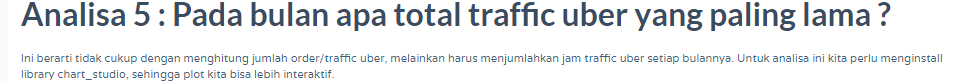

In [34]:
!pip install chart_studio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 64 kB 1.7 MB/s 
  Created wheel for retrying: filename=retrying-1.3.3-py3-none-any.whl size=11447 sha256=8a4ac81cf66c55fcb586652922083c8c7e1b79e5b9f9c9d4fd5e89470239f5b7
  Stored in directory: /root/.cache/pip/wheels/f9/8d/8d/f6af3f7f9eea3553bc2fe6d53e4b287dad18b06a861ac56ddf
Successfully built retrying


In [35]:
import chart_studio.plotly as pyplot
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode,plot,iplot

In [36]:
trace1=go.Bar(
    x=df.groupby('month')['hour'].sum().index,
    y=df.groupby('month')['hour'].sum(),
    name='Priority')

iplot([trace1])

## Analysis 6
> total perjalanan uber berdasarkan tanggal dalam 1 bulan selama 2014 

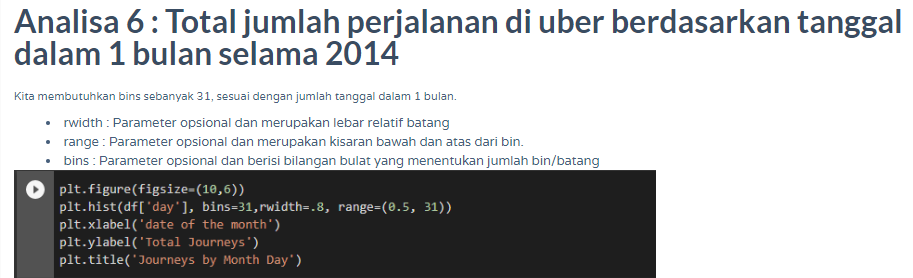

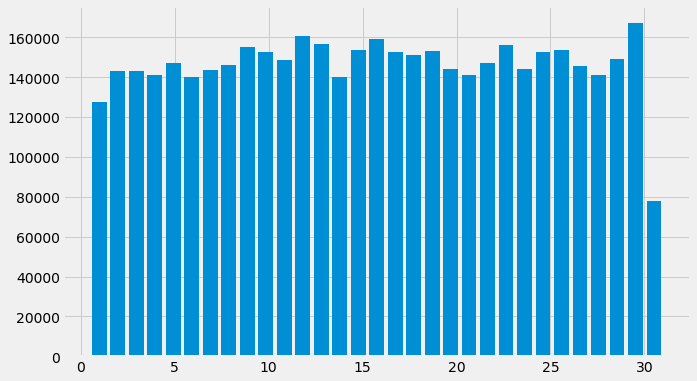

In [37]:
plt.figure(figsize=(10,6))
plt.hist(df['day'],bins=31,rwidth=.8,range=(0.5,31));

## Analysis 7

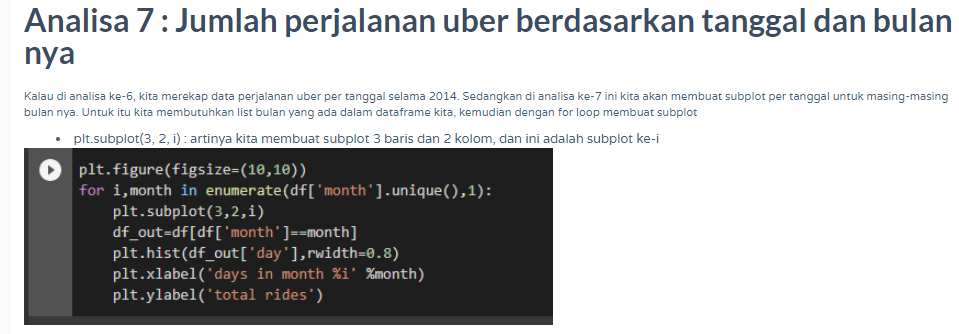

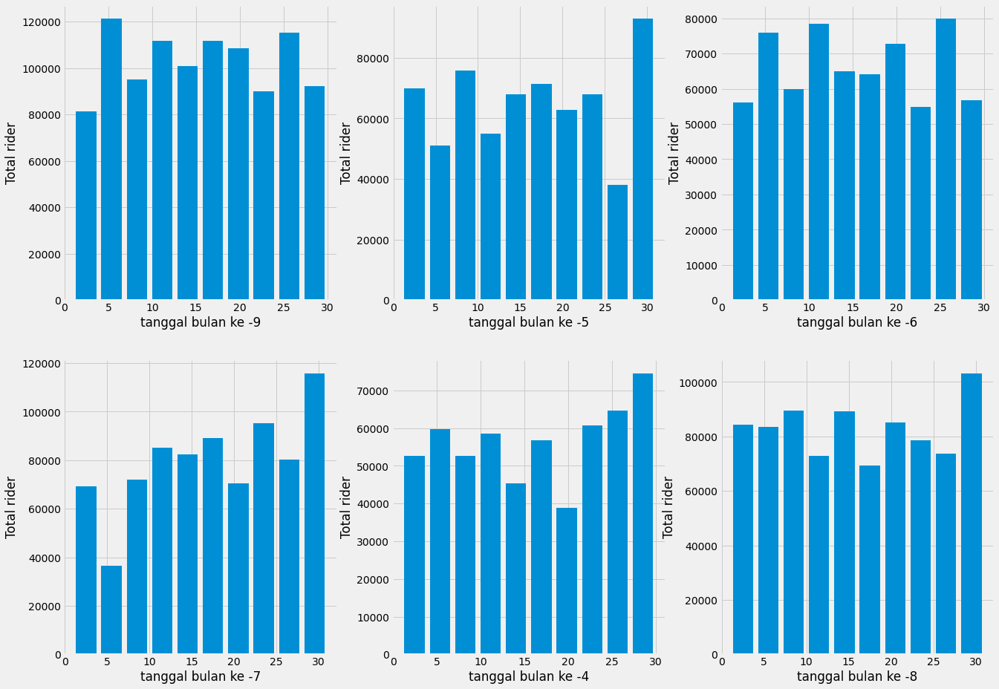

In [38]:
plt.figure(figsize=(20,15))
for i, bulan in enumerate(df['month'].unique(),1):
  plt.subplot(2,3,i)
  df[df['month']==bulan]['day'].hist(rwidth=.8)
  plt.xlabel ('tanggal bulan ke -%i'%bulan)
  plt.ylabel ('Total rider')

## Analysis 8

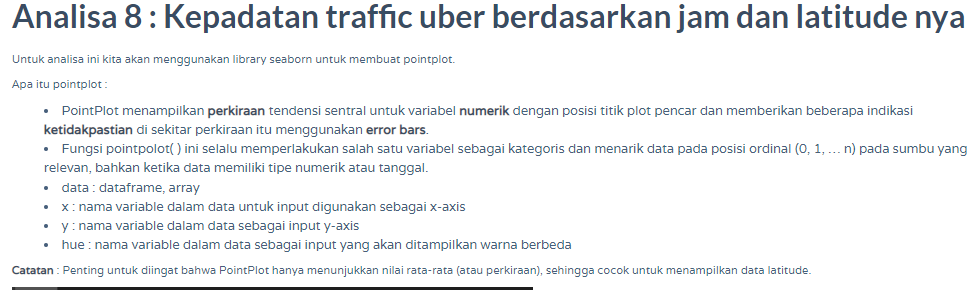

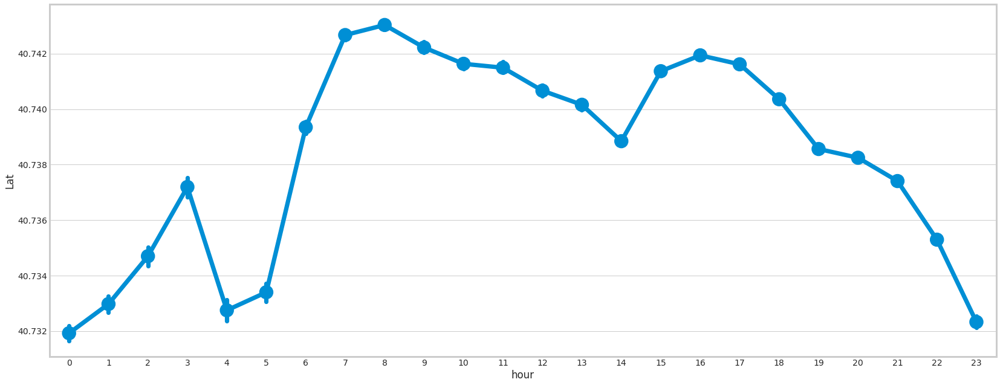

In [39]:
sns.set_style(style='whitegrid')
plt.figure(figsize=(25,10))
sns.pointplot(x='hour',y='Lat',data=df)

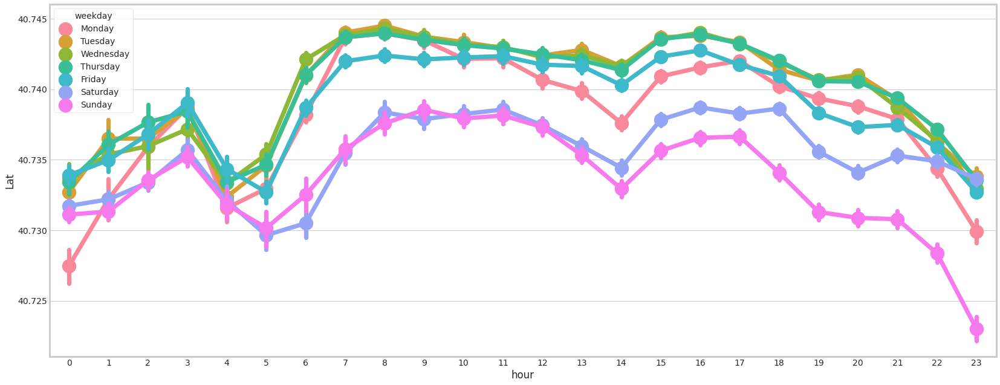

In [40]:
sns.set_style(style='whitegrid')
plt.figure(figsize=(25,10))
ax=sns.pointplot(x='hour',y='Lat',data=df,hue='weekday')

## Analysis 9

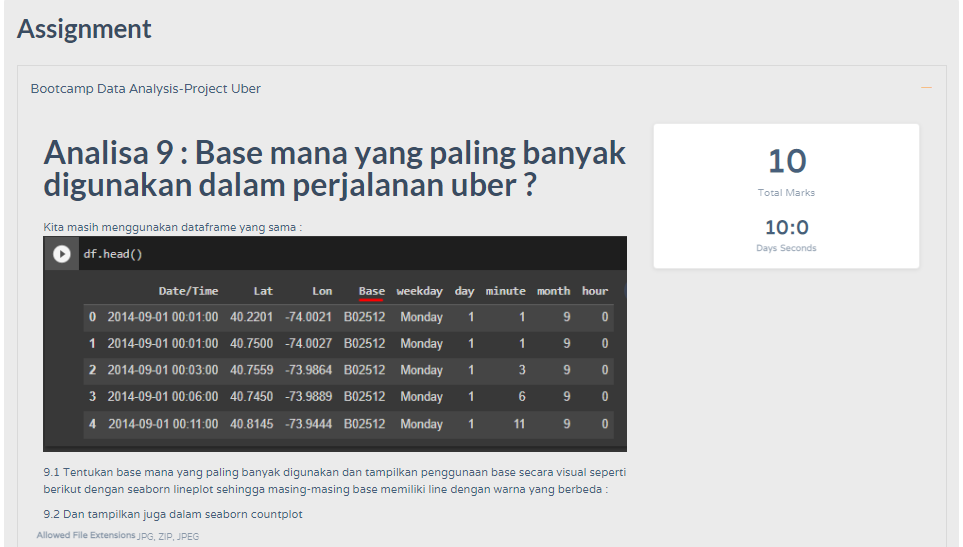

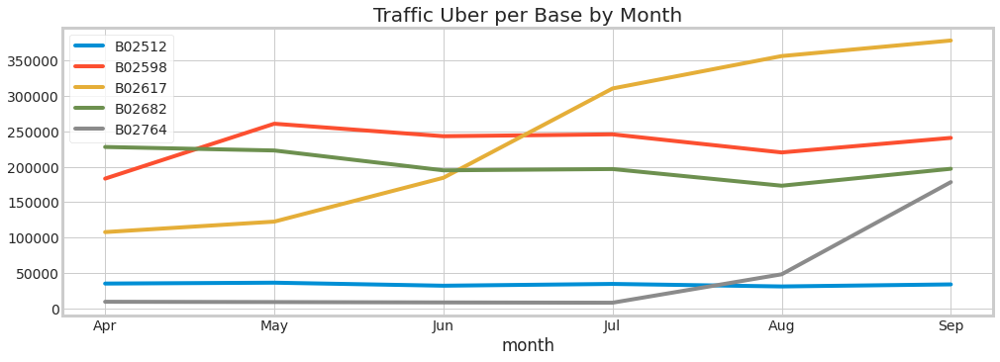

In [45]:
## 9.1
sns.set_style(style='whitegrid')
plt.figure(figsize=(15,5))
ax=df.groupby(['Base','month'])['month'].count().reset_index(name='Jumlah perjalanan')
sns.lineplot(data=ax, x="month", y="Jumlah perjalanan", hue="Base")
plt.ylabel('')
plt.title('Traffic Uber per Base by Month')
plt.xticks([4,5,6,7,8,9], #koordinat asli
          ['Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep'])
plt.legend(loc='best');

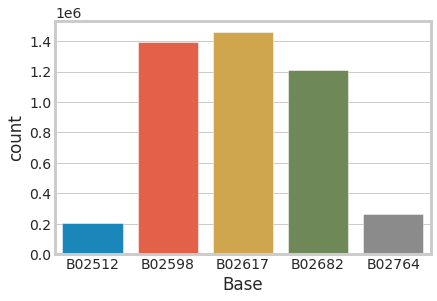

In [46]:
# 9.2
sns.countplot(data=df,x='Base')

# Part 2 Uber Project Cross Analysis

## Analisis 1 part 2

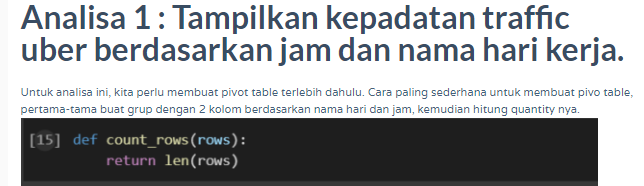

In [47]:
len(df.query('weekday=="Friday" & hour==0'))

13716

In [48]:
def count_rows(rows):
  return len(rows)

by_cross = df.groupby(['weekday','hour']).apply(lambda x : count_rows(x))
by_cross # Multiindex disebut Stack()

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [49]:
pivot = by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


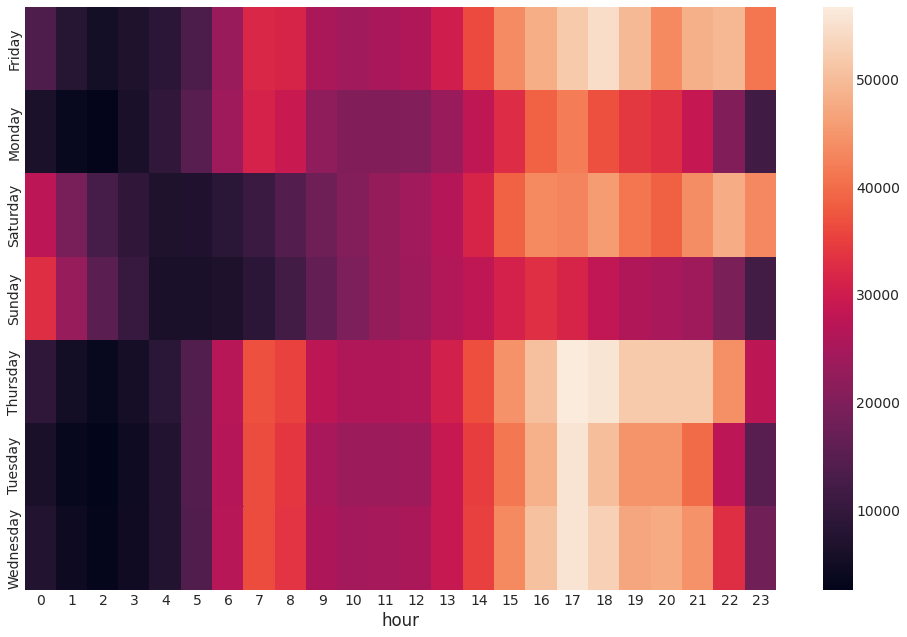

In [50]:
plt.figure(figsize=(15,10))
sns.heatmap(pivot, annot=None)
plt.ylabel('');

In [51]:
def heatmap(col1,col2):
  cross=df.groupby([col1,col2]).apply(lambda x:len(x))
  pivot2 = cross.unstack()
  plt.figure(figsize=(20,15))
  sns.heatmap(pivot2, annot=None)

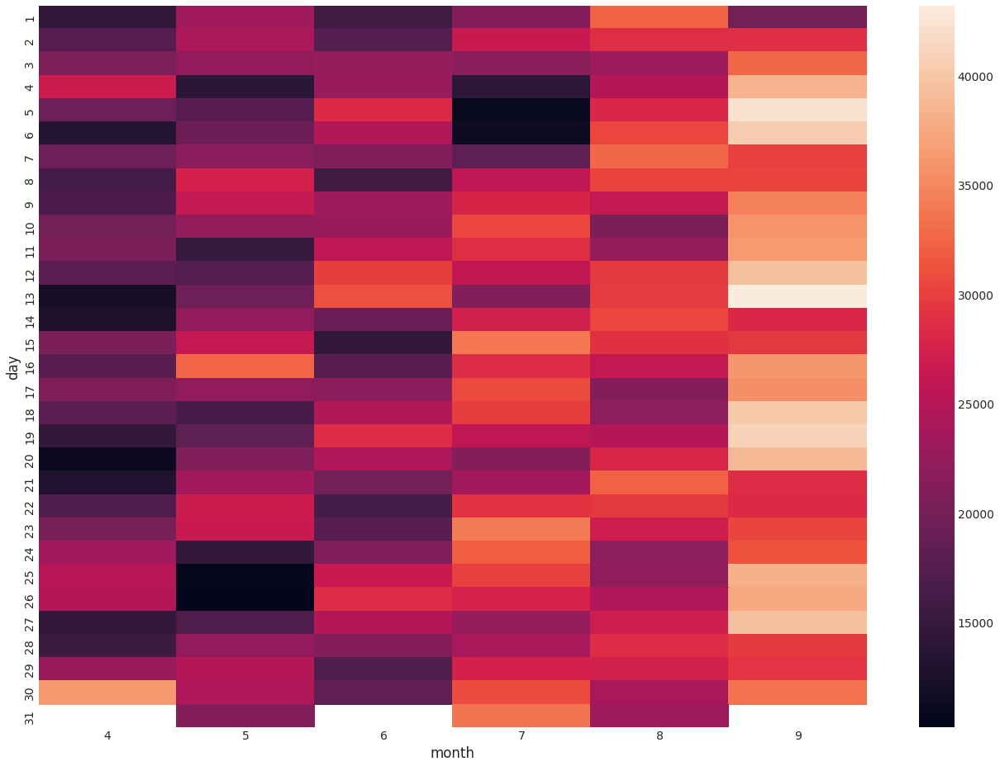

In [52]:
heatmap('day','month')

In [53]:
df2=df.query('month==4')
df2

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0
...,...,...,...,...,...,...,...,...,...
564511,2014-04-30 23:22:00,40.7640,-73.9744,B02764,Wednesday,30,22,4,23
564512,2014-04-30 23:26:00,40.7629,-73.9672,B02764,Wednesday,30,26,4,23
564513,2014-04-30 23:31:00,40.7443,-73.9889,B02764,Wednesday,30,31,4,23
564514,2014-04-30 23:32:00,40.6756,-73.9405,B02764,Wednesday,30,32,4,23


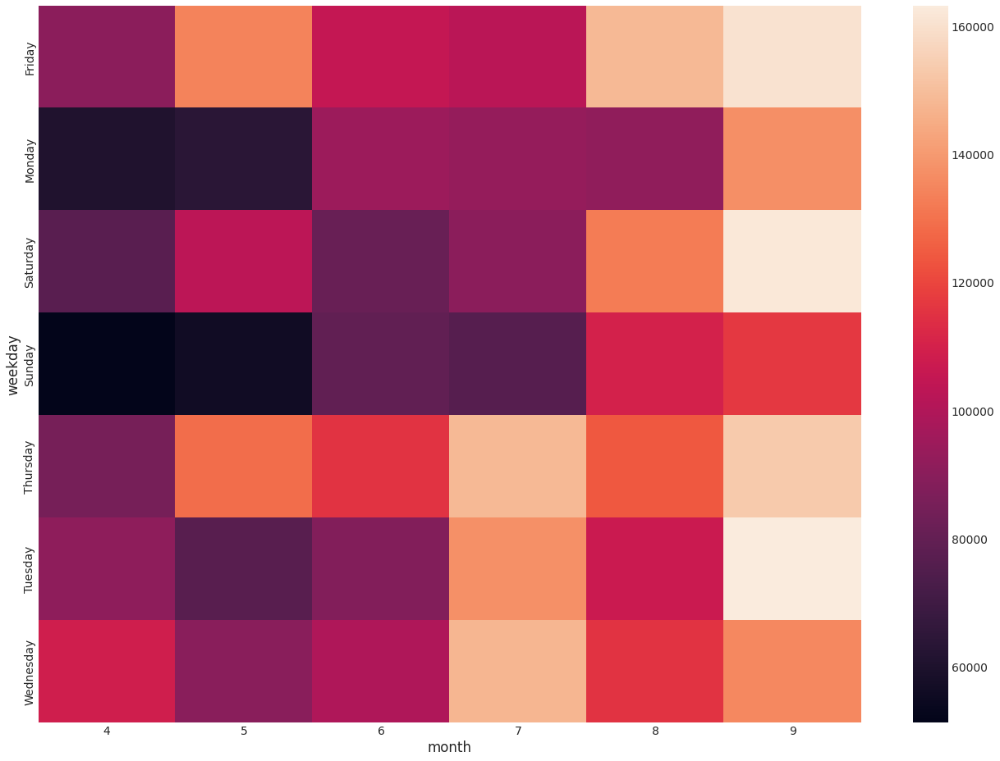

In [54]:
heatmap('weekday','month')

In [55]:
def heatmap2(col1,col2):
  cross=df2.groupby([col1,col2]).apply(lambda x:len(x))
  pivot2 = cross.unstack()
  plt.figure(figsize=(20,15))
  sns.heatmap(pivot2, annot=None)

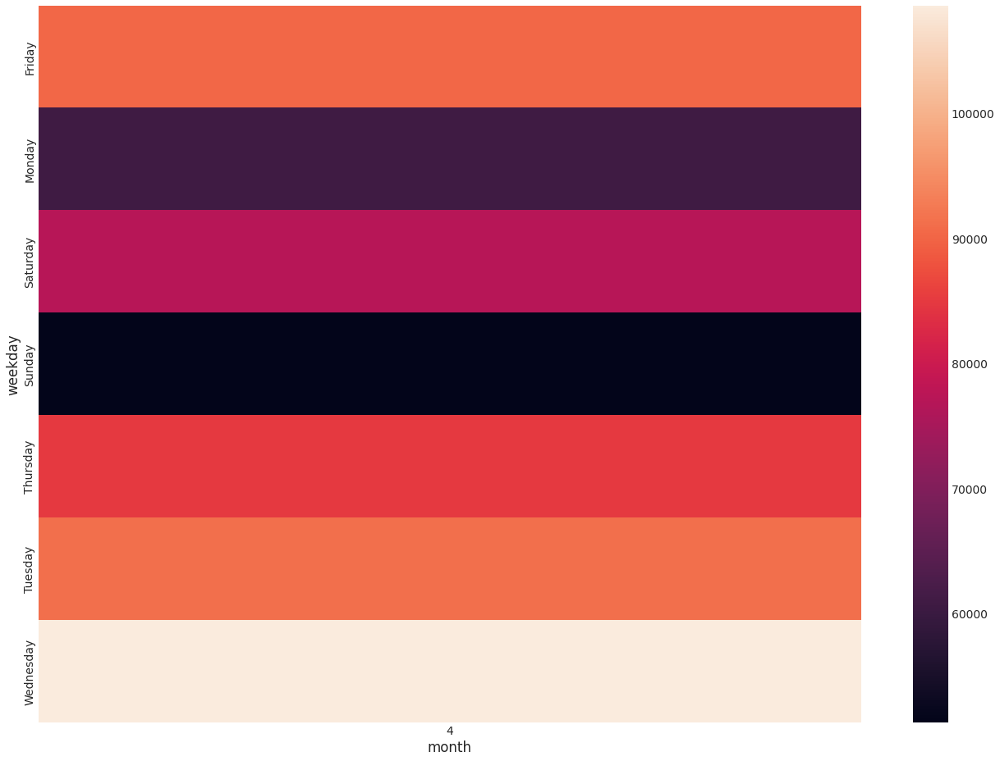

In [56]:
heatmap2('weekday','month')

## Analisis 2 Part 2

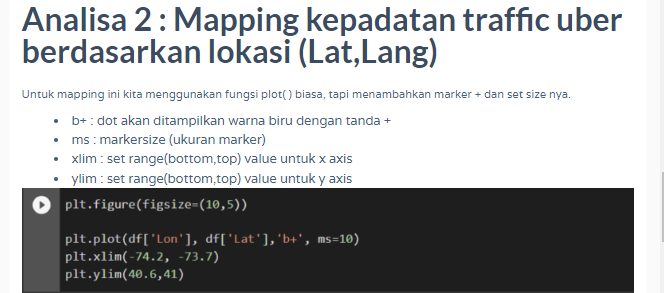

(40.6, 41.0)

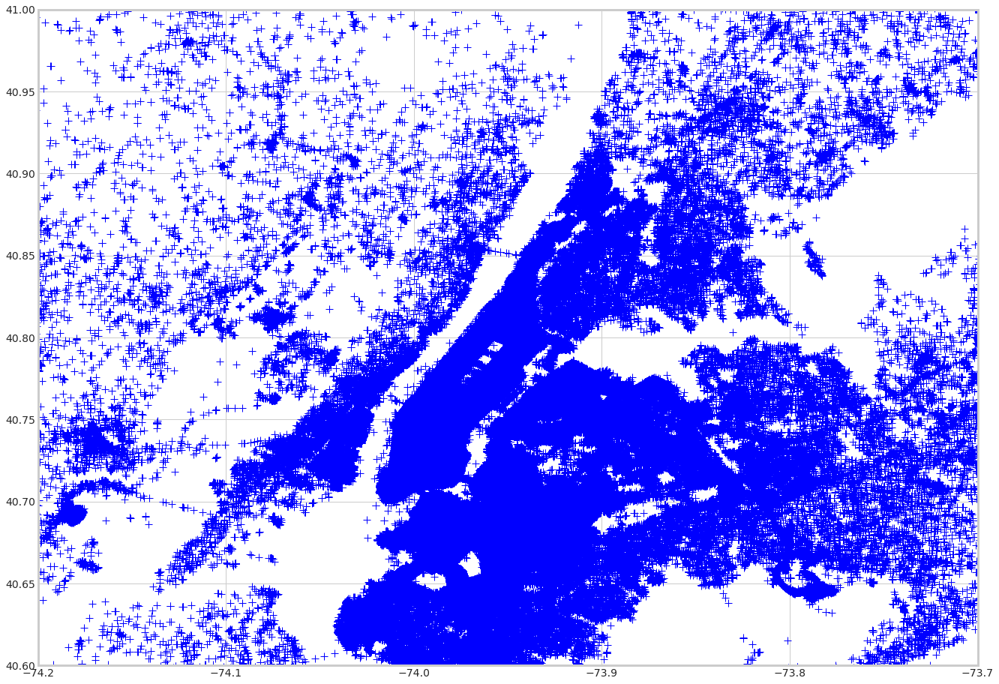

In [57]:
plt.figure(figsize=(20,15))
plt.plot(df['Lon'], df['Lat'],'b+',ms=10)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

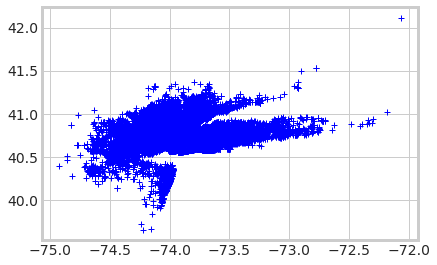

In [58]:
import matplotlib as mpl
mpl.rcParams['agg.path.chunksize'] = 10000
plt.plot(df['Lon'], df['Lat'],'b+')

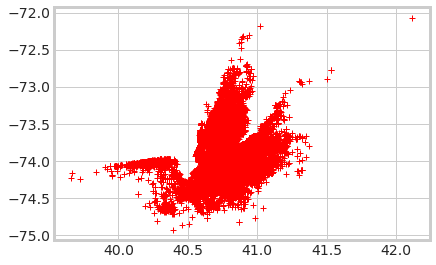

In [59]:
import matplotlib as mpl
mpl.rcParams['agg.path.chunksize'] = 10000
plt.plot(df['Lat'],df['Lon'],'r+')

In [60]:
from folium.plugins import HeatMap
import folium
from folium.plugins import HeatMap
basemap=folium.Map()

In [61]:
df_libur=df.query('weekday == "Sunday"')

In [62]:
HeatMap(data=df_libur.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)

In [63]:
basemap

In [64]:
def maping(df,day):
  df_libur=df[df['weekday']==day]
  df_libur.groupby(['Lat','Lon'])['weekday'].count().reset_index()
  HeatMap(data=df_libur.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
  return basemap

In [65]:
maping(df,'Sunday')